In [1]:
import pandas as pd
import scipy.io
import scanpy as sc
import gzip

# Paths to files
mtx_file = "/mnt/data/melhajjar/tabula_muris/lung_raw_data/matrix/matrix.mtx.gz"
features_file = "/mnt/data/melhajjar/tabula_muris/lung_raw_data/matrix/features.tsv.gz"
barcodes_file = "/mnt/data/melhajjar/tabula_muris/lung_raw_data/matrix/barcodes.tsv.gz"

# Read barcodes and features
barcodes_df = pd.read_csv(barcodes_file, sep='\t', header=None)
features_df = pd.read_csv(features_file, sep='\t', header=None)

# Read and transpose matrix
with gzip.open(mtx_file, 'rb') as f:
    matrix = scipy.io.mmread(f).T  # Transpose to shape (cells, genes)

# Convert to CSR format immediately
matrix = matrix.tocsr()

# Create AnnData object
adata = sc.AnnData(X=matrix)
adata.obs_names = barcodes_df[0].values
adata.var_names = features_df[1].values  # Gene symbols
adata.var['gene_ids'] = features_df[0].values
if features_df.shape[1] > 2:
    adata.var['feature_types'] = features_df[2].values

# Ensure adata is not a view
adata = adata.copy()

# Confirm all sparse matrices are in CSR format
adata.X = adata.X.tocsr()  # Main matrix
if hasattr(adata, "raw") and adata.raw is not None:
    adata.raw.X = adata.raw.X.tocsr()

# Now filter cells and genes
sc.pp.filter_cells(adata, min_genes=100)  # Filter cells with at least 100 genes
sc.pp.filter_genes(adata, min_cells=3)   # Filter genes expressed in at least 3 cells

# Check results
print(adata)


AnnData object with n_obs × n_vars = 24540 × 16938
    obs: 'n_genes'
    var: 'gene_ids', 'feature_types', 'n_cells'


In [2]:
# Path to metadata file
metadata_file = "/mnt/data/melhajjar/tabula_muris/GSM4505404_tabula-muris-senis-droplet-official-raw-obj-metadata.csv"

# Load metadata
metadata = pd.read_csv(metadata_file, index_col=0)  # Use the barcode column as the index

metadata = metadata.loc[metadata.index.isin(adata.obs_names)]

# metadata

/tmp/ipykernel_31202/3674024157.py:5: DtypeWarning: Columns (4) have mixed types. Specify dtype option on import or set low_memory=False.
  metadata = pd.read_csv(metadata_file, index_col=0)  # Use the barcode column as the index


In [3]:
# Reindex metadata to match adata.obs_names
metadata = metadata.reindex(adata.obs_names, fill_value=None)  # Fill missing with NaN (optional)

# Drop any rows with NaN to remove unmatched barcodes (optional)
metadata = metadata.dropna(how="all")


In [4]:
adata.obs = adata.obs.join(metadata, rsuffix="_meta")

# Check the result
print(adata.obs.head())


                           n_genes  age                                 cell  \
AAACGGGTCGCCCTTA-1-11-0-0     1821  18m  MACA_18m_F_LUNG_50_AAACGGGTCGCCCTTA   
AAAGATGAGCAGACTG-1-11-0-0     1333  18m  MACA_18m_F_LUNG_50_AAAGATGAGCAGACTG   
AAAGATGAGCCGTCGT-1-11-0-0     1455  18m  MACA_18m_F_LUNG_50_AAAGATGAGCCGTCGT   
AAAGCAACATGGTAGG-1-11-0-0     3322  18m  MACA_18m_F_LUNG_50_AAAGCAACATGGTAGG   
AAAGCAAGTCTAGTGT-1-11-0-0     1120  18m  MACA_18m_F_LUNG_50_AAAGCAAGTCTAGTGT   

                              cell_ontology_class cell_ontology_id  \
AAACGGGTCGCCCTTA-1-11-0-0                  B cell              NaN   
AAAGATGAGCAGACTG-1-11-0-0  non-classical monocyte              NaN   
AAAGATGAGCCGTCGT-1-11-0-0                 NK cell              NaN   
AAAGCAACATGGTAGG-1-11-0-0     alveolar macrophage              NaN   
AAAGCAAGTCTAGTGT-1-11-0-0                  B cell              NaN   

                                 free_annotation   method mouse.id  \
AAACGGGTCGCCCTTA-1-11-0-0   

In [5]:
# Filter out samples where adata.obs['sex'] is "female"
adata = adata[adata.obs['sex'] != "female"]


In [6]:
# Saving count data
adata.layers["counts"] = adata.X.copy()

/tmp/ipykernel_31202/2262359327.py:2: ImplicitModificationWarning: Setting element `.layers['counts']` of view, initializing view as actual.
  adata.layers["counts"] = adata.X.copy()


In [26]:
# Define the specific cell types of interest
selected_cell_types = [
    "classical monocyte",
    "non-classical monocyte",
    "alveolar macrophage",
    "lung macrophage",
    "intermediate monocyte"
]

# Create a dictionary of AnnData objects for each selected cell type
selected_adata_dfs = {cell_type: adata[adata.obs['cell_ontology_class'] == cell_type].copy()
                      for cell_type in selected_cell_types}

# Print number of cells per selected type
for cell_type, adata_subset in selected_adata_dfs.items():
    print(f"{cell_type}: {adata_subset.shape[0]} cells")


classical monocyte: 7407 cells
non-classical monocyte: 553 cells
alveolar macrophage: 1044 cells
lung macrophage: 1123 cells
intermediate monocyte: 1659 cells


Processing classical monocyte...


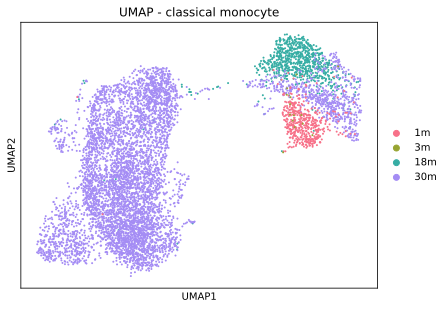

Processing non-classical monocyte...


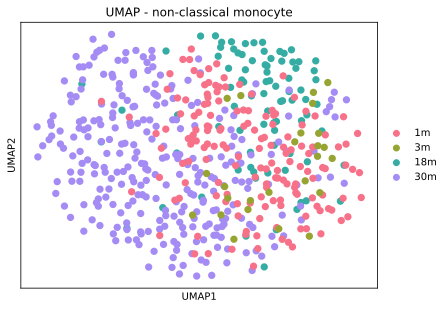

Processing alveolar macrophage...


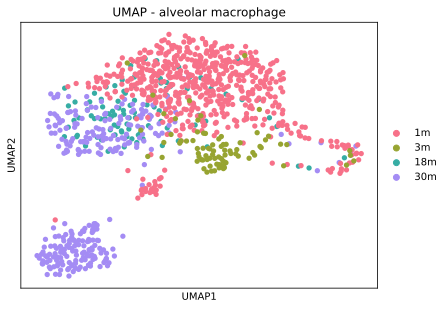

Processing lung macrophage...


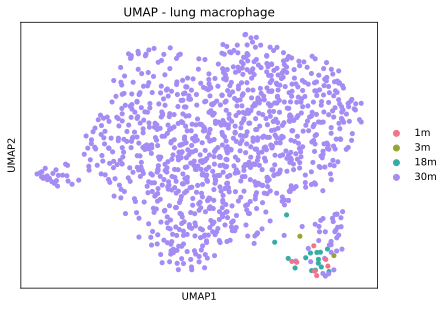

Processing intermediate monocyte...


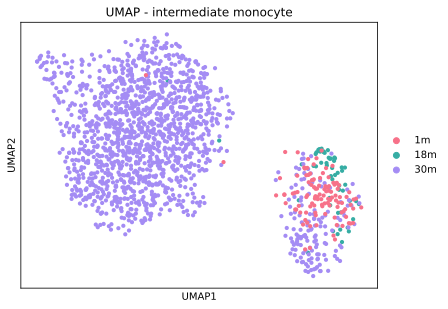

In [27]:
for cell_type, adata_subset in selected_adata_dfs.items():
    print(f"Processing {cell_type}...")

    # Step 1: Identify Highly Variable Genes for this cell type
    sc.pp.highly_variable_genes(adata_subset, n_top_genes=2000, batch_key="age")

    # Step 2: Normalize and log-transform
    sc.pp.normalize_total(adata_subset, target_sum=1e4)
    sc.pp.log1p(adata_subset)

    # Step 3: Scale the data
    sc.pp.scale(adata_subset, max_value=10)

    # Step 4: PCA
    sc.tl.pca(adata_subset)

    # Step 5: Compute neighborhood graph
    sc.pp.neighbors(adata_subset, n_pcs=50)

    # Step 6: Compute UMAP
    sc.tl.umap(adata_subset)

    # Step 7: Plot UMAP
    sc.pl.umap(adata_subset, color="age", title=f"UMAP - {cell_type}")
    
    # (Optional) Save the processed subset
    # adata_subset.write(f"{cell_type}_subset.h5ad")


Processing all selected cell types together...


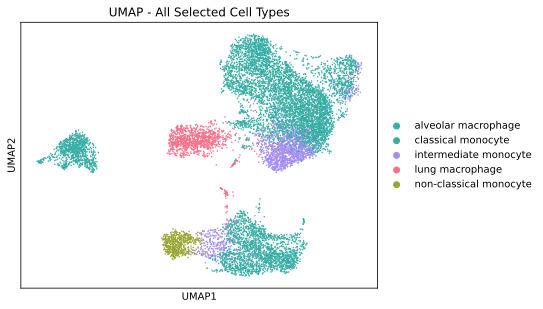

Processing age group 1m...
Processing age group 3m...
Processing age group 18m...
Processing age group 30m...


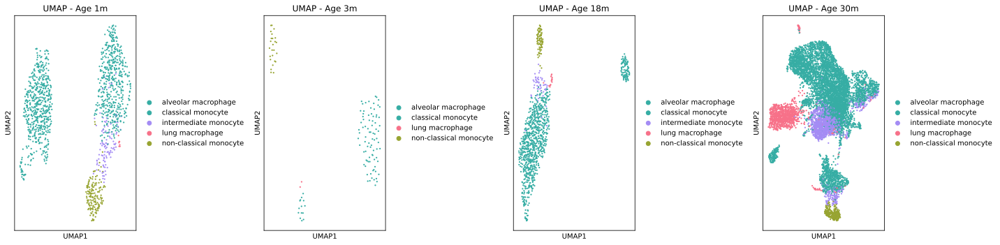

In [30]:
import matplotlib.pyplot as plt
import scanpy as sc
import numpy as np

# Merge selected cell types into one dataset
adata_selected = adata[adata.obs['cell_ontology_class'].isin(selected_adata_dfs.keys())].copy()

# General Preprocessing for Combined Data
print("Processing all selected cell types together...")

# Step 1: Identify Highly Variable Genes
sc.pp.highly_variable_genes(adata_selected, n_top_genes=2000, batch_key="age")

# Step 2: Normalize and log-transform
sc.pp.normalize_total(adata_selected, target_sum=1e4)
sc.pp.log1p(adata_selected)

# Step 3: Scale the data
sc.pp.scale(adata_selected, max_value=10)

# Step 4: PCA
sc.tl.pca(adata_selected)

# Step 5: Compute neighborhood graph
sc.pp.neighbors(adata_selected, n_pcs=50)

# Step 6: Compute UMAP
sc.tl.umap(adata_selected)

# Step 7: Plot general UMAP (all selected cell types together)
sc.pl.umap(adata_selected, color="cell_ontology_class", title="UMAP - All Selected Cell Types")

# Step 8: Separate UMAPs for Each Age Group
ages = sorted(adata_selected.obs['age'].unique(), key=lambda x: int(x.replace('m', '')))
dot_size = 20  # Consistent dot size for all plots

fig, axes = plt.subplots(1, len(ages), figsize=(5 * len(ages), 5))

if len(ages) == 1:
    axes = [axes]  # Ensure it's iterable even if only one subplot

for ax, age in zip(axes, ages):
    print(f"Processing age group {age}...")

    # Subset for the given age
    adata_age = adata_selected[adata_selected.obs["age"] == age].copy()

    # Compute UMAP for this age separately
    sc.pp.neighbors(adata_age)
    sc.tl.umap(adata_age)
    sc.tl.leiden(adata_age)  # Clustering

    # Plot UMAP with Leiden clusters, ensuring consistent dot size
    sc.pl.umap(
        adata_age,
        color="cell_ontology_class",
        ax=ax,
        title=f"UMAP - Age {age}",
        show=False,
        size=dot_size
    )

plt.tight_layout()
plt.show()


Processing all selected cell types together...


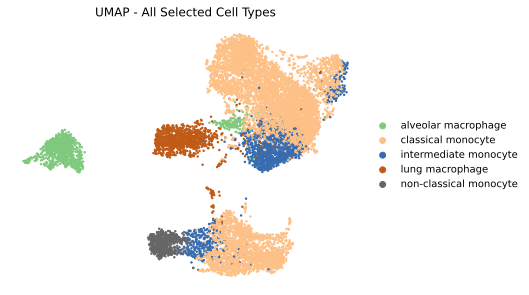

Processing age group 1m...
Processing age group 3m...
Processing age group 18m...
Processing age group 30m...


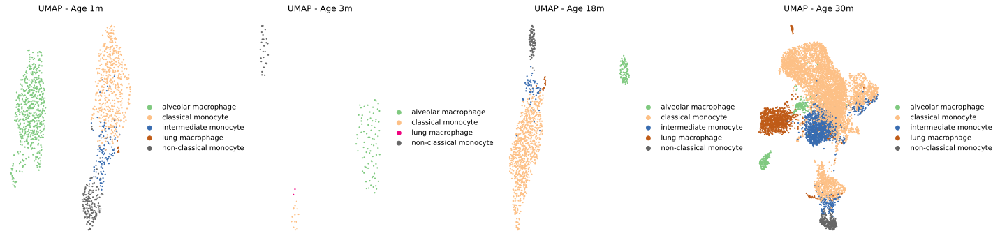

/tmp/ipykernel_31202/33264110.py:71: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_type_counts = adata_selected.obs.groupby(['age', 'cell_ontology_class']).size().unstack(fill_value=0)


<Figure size 1000x600 with 0 Axes>

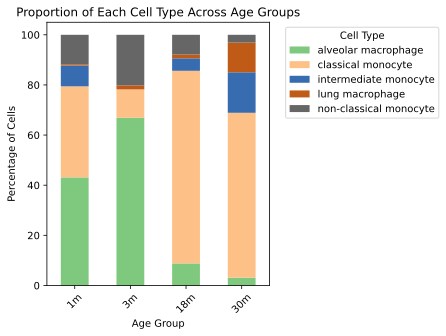

In [42]:
import matplotlib.pyplot as plt
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns

# Merge selected cell types into one dataset
adata_selected = adata[adata.obs['cell_ontology_class'].isin(selected_adata_dfs.keys())].copy()

# General Preprocessing for Combined Data
print("Processing all selected cell types together...")

# Step 1: Identify Highly Variable Genes
sc.pp.highly_variable_genes(adata_selected, n_top_genes=2000, batch_key="age")

# Step 2: Normalize and log-transform
sc.pp.normalize_total(adata_selected, target_sum=1e4)
sc.pp.log1p(adata_selected)

# Step 3: Scale the data
sc.pp.scale(adata_selected, max_value=10)

# Step 4: PCA
sc.tl.pca(adata_selected)

# Step 5: Compute neighborhood graph
sc.pp.neighbors(adata_selected, n_pcs=50)

# Step 6: Compute UMAP
sc.tl.umap(adata_selected)

# Step 7: Plot general UMAP (all selected cell types together)
sc.pl.umap(adata_selected, color="cell_ontology_class", title="UMAP - All Selected Cell Types", palette="Accent", frameon=False, size=25)

# Step 8: Separate UMAPs for Each Age Group
ages = sorted(adata_selected.obs['age'].unique(), key=lambda x: int(x.replace('m', '')))
dot_size = 20  # Consistent dot size for all plots

fig, axes = plt.subplots(1, len(ages), figsize=(5 * len(ages), 5))

if len(ages) == 1:
    axes = [axes]  # Ensure it's iterable even if only one subplot

for ax, age in zip(axes, ages):
    print(f"Processing age group {age}...")

    # Subset for the given age
    adata_age = adata_selected[adata_selected.obs["age"] == age].copy()

    # Compute UMAP for this age separately
    sc.pp.neighbors(adata_age)
    sc.tl.umap(adata_age)
    sc.tl.leiden(adata_age)  # Clustering

    # Plot UMAP with Leiden clusters, ensuring consistent dot size
    sc.pl.umap(
        adata_age,
        color="cell_ontology_class",
        ax=ax,
        title=f"UMAP - Age {age}",
        show=False,
        size=dot_size,
        frameon=False,
        palette="Accent"
    )

plt.tight_layout()
plt.show()

# Step 9: Compute Cell Type Proportions for Each Age Group
cell_type_counts = adata_selected.obs.groupby(['age', 'cell_ontology_class']).size().unstack(fill_value=0)

# Convert counts to percentages within each age group
cell_type_percentages = cell_type_counts.div(cell_type_counts.sum(axis=1), axis=0) * 100

# Plot Bar Graph for Cell Type Proportions
plt.figure(figsize=(10, 6))
cell_type_percentages.plot(kind='bar', stacked=True, cmap="Accent")

plt.ylabel("Percentage of Cells")
plt.xlabel("Age Group")
plt.title("Proportion of Each Cell Type Across Age Groups")
plt.legend(title="Cell Type", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [50]:
import itertools
import scipy.stats as stats

for cell_type in cell_type_counts.columns:
    print(f"\n==== Fisher’s Exact Test for {cell_type} ====")

    # Get counts for this cell type
    cell_counts = cell_type_counts[cell_type]

    # Remove age groups with zero cells
    nonzero_ages = cell_counts[cell_counts > 0].index
    filtered_counts = cell_counts[nonzero_ages]

    # If fewer than 2 age groups remain, we cannot perform the test
    if len(filtered_counts) < 2:
        print(f"  → Skipping Fisher’s test for {cell_type} (not enough data).")
        continue

    # Perform pairwise Fisher's Exact Test for each age group pair
    for age1, age2 in itertools.combinations(nonzero_ages, 2):
        table = np.array([
            [cell_counts[age1], cell_type_counts.sum(axis=1)[age1] - cell_counts[age1]],
            [cell_counts[age2], cell_type_counts.sum(axis=1)[age2] - cell_counts[age2]]
        ])

        # Run Fisher’s Exact Test
        _, p_value = stats.fisher_exact(table)

        print(f"  → {cell_type} comparison ({age1} vs {age2}): P-Value = {p_value}")

        if p_value < 0.05:
            print(f"     ** Significant difference between {age1} and {age2} for {cell_type}! **")




==== Fisher’s Exact Test for alveolar macrophage ====
  → alveolar macrophage comparison (1m vs 3m): P-Value = 4.1048779058000025e-07
     ** Significant difference between 1m and 3m for alveolar macrophage! **
  → alveolar macrophage comparison (1m vs 18m): P-Value = 1.1482276729141981e-84
     ** Significant difference between 1m and 18m for alveolar macrophage! **
  → alveolar macrophage comparison (1m vs 30m): P-Value = 0.0
     ** Significant difference between 1m and 30m for alveolar macrophage! **
  → alveolar macrophage comparison (3m vs 18m): P-Value = 9.481682276568628e-47
     ** Significant difference between 3m and 18m for alveolar macrophage! **
  → alveolar macrophage comparison (3m vs 30m): P-Value = 1.3076249081387095e-88
     ** Significant difference between 3m and 30m for alveolar macrophage! **
  → alveolar macrophage comparison (18m vs 30m): P-Value = 3.7141361051396265e-16
     ** Significant difference between 18m and 30m for alveolar macrophage! **

==== Fishe

In [51]:
import itertools
import scipy.stats as stats
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Store results in a dictionary
p_values_dict = {}

for cell_type in cell_type_counts.columns:
    print(f"\n==== Fisher’s Exact Test for {cell_type} ====")

    # Get counts for this cell type
    cell_counts = cell_type_counts[cell_type]

    # Remove age groups with zero cells
    nonzero_ages = cell_counts[cell_counts > 0].index
    filtered_counts = cell_counts[nonzero_ages]

    # If fewer than 2 age groups remain, we cannot perform the test
    if len(filtered_counts) < 2:
        print(f"  → Skipping Fisher’s test for {cell_type} (not enough data).")
        continue

    # Initialize dictionary for this cell type
    p_values_dict[cell_type] = {}

    # Perform pairwise Fisher's Exact Test
    for age1, age2 in itertools.combinations(nonzero_ages, 2):
        table = np.array([
            [cell_counts[age1], cell_type_counts.sum(axis=1)[age1] - cell_counts[age1]],
            [cell_counts[age2], cell_type_counts.sum(axis=1)[age2] - cell_counts[age2]]
        ])

        # Run Fisher’s Exact Test
        _, p_value = stats.fisher_exact(table)

        # Store the p-value
        p_values_dict[cell_type][f"{age1} vs {age2}"] = p_value

        print(f"  → {cell_type} comparison ({age1} vs {age2}): P-Value = {p_value}")

        if p_value < 0.05:
            print(f"     ** Significant difference between {age1} and {age2} for {cell_type}! **")

# Convert dictionary to DataFrame for visualization
p_values_df = pd.DataFrame(p_values_dict).T  # Transpose for better visualization

# Replace NaN with 1 (since NaN means no comparison was possible)
p_values_df = p_values_df.fillna(1)



==== Fisher’s Exact Test for alveolar macrophage ====
  → alveolar macrophage comparison (1m vs 3m): P-Value = 4.1048779058000025e-07
     ** Significant difference between 1m and 3m for alveolar macrophage! **
  → alveolar macrophage comparison (1m vs 18m): P-Value = 1.1482276729141981e-84
     ** Significant difference between 1m and 18m for alveolar macrophage! **
  → alveolar macrophage comparison (1m vs 30m): P-Value = 0.0
     ** Significant difference between 1m and 30m for alveolar macrophage! **
  → alveolar macrophage comparison (3m vs 18m): P-Value = 9.481682276568628e-47
     ** Significant difference between 3m and 18m for alveolar macrophage! **
  → alveolar macrophage comparison (3m vs 30m): P-Value = 1.3076249081387095e-88
     ** Significant difference between 3m and 30m for alveolar macrophage! **
  → alveolar macrophage comparison (18m vs 30m): P-Value = 3.7141361051396265e-16
     ** Significant difference between 18m and 30m for alveolar macrophage! **

==== Fishe

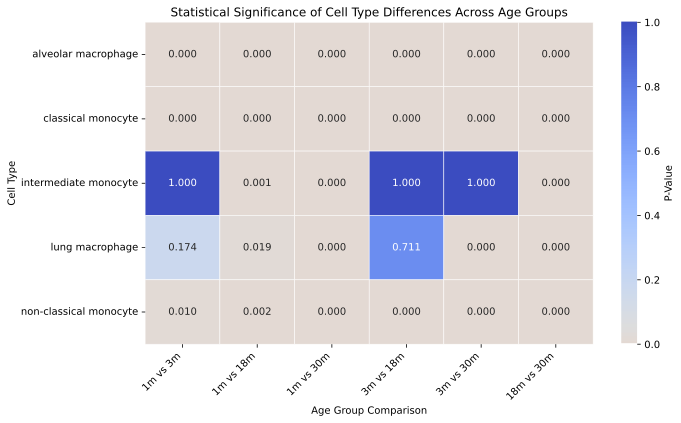

In [53]:
# Plot heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(
    p_values_df, 
    annot=True, 
    cmap="coolwarm_r", 
    center=0.05,  # Set 0.05 as midpoint for clear significance
    linewidths=0.5,
    cbar_kws={'label': 'P-Value'},
    fmt=".3f"  # Show 3 decimal places for clarity
)

plt.title("Statistical Significance of Cell Type Differences Across Age Groups")
plt.xlabel("Age Group Comparison")
plt.ylabel("Cell Type")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


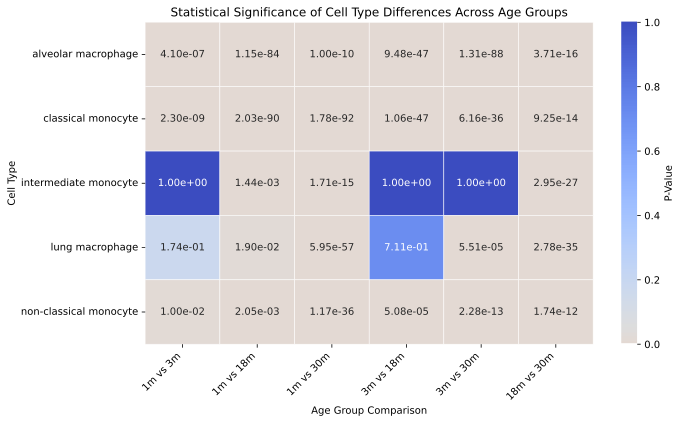

In [54]:
# Replace exact 0s with a small number for visualization clarity
p_values_df = p_values_df.replace(0, 1e-10)

# Plot the heatmap again
plt.figure(figsize=(10, 6))
sns.heatmap(
    p_values_df, 
    annot=True, 
    cmap="coolwarm_r", 
    center=0.05,  
    linewidths=0.5,
    cbar_kws={'label': 'P-Value'},
    fmt=".2e"  # Show scientific notation for small values
)

plt.title("Statistical Significance of Cell Type Differences Across Age Groups")
plt.xlabel("Age Group Comparison")
plt.ylabel("Cell Type")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [55]:
import itertools
import scipy.stats as stats
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Store results in a dictionary
p_values_dict = {}

for cell_type in cell_type_counts.columns:
    print(f"\n==== Fisher’s Exact Test for {cell_type} ====")

    # Get counts for this cell type
    cell_counts = cell_type_counts[cell_type]

    # Remove age groups with zero cells
    nonzero_ages = cell_counts[cell_counts > 0].index
    filtered_counts = cell_counts[nonzero_ages]

    # If fewer than 2 age groups remain, we cannot perform the test
    if len(filtered_counts) < 2:
        print(f"  → Skipping Fisher’s test for {cell_type} (not enough data).")
        continue

    # Initialize dictionary for this cell type
    p_values_dict[cell_type] = {}

    # Perform pairwise Fisher's Exact Test
    for age1, age2 in itertools.combinations(nonzero_ages, 2):
        table = np.array([
            [cell_counts[age1], cell_type_counts.sum(axis=1)[age1] - cell_counts[age1]],
            [cell_counts[age2], cell_type_counts.sum(axis=1)[age2] - cell_counts[age2]]
        ])

        # Run Fisher’s Exact Test
        _, p_value = stats.fisher_exact(table)

        # Store the true p-value (not rounded to zero)
        p_values_dict[cell_type][f"{age1} vs {age2}"] = max(p_value, np.finfo(float).tiny)  # Ensure small values are kept

        print(f"  → {cell_type} comparison ({age1} vs {age2}): P-Value = {p_value:.3e}")

# Convert dictionary to DataFrame for visualization
p_values_df = pd.DataFrame(p_values_dict).T  # Transpose for better visualization

# Replace NaN with 1 (since NaN means no comparison was possible)
p_values_df = p_values_df.fillna(1)



==== Fisher’s Exact Test for alveolar macrophage ====
  → alveolar macrophage comparison (1m vs 3m): P-Value = 4.105e-07
  → alveolar macrophage comparison (1m vs 18m): P-Value = 1.148e-84
  → alveolar macrophage comparison (1m vs 30m): P-Value = 0.000e+00
  → alveolar macrophage comparison (3m vs 18m): P-Value = 9.482e-47
  → alveolar macrophage comparison (3m vs 30m): P-Value = 1.308e-88
  → alveolar macrophage comparison (18m vs 30m): P-Value = 3.714e-16

==== Fisher’s Exact Test for classical monocyte ====
  → classical monocyte comparison (1m vs 3m): P-Value = 2.302e-09
  → classical monocyte comparison (1m vs 18m): P-Value = 2.030e-90
  → classical monocyte comparison (1m vs 30m): P-Value = 1.780e-92
  → classical monocyte comparison (3m vs 18m): P-Value = 1.060e-47
  → classical monocyte comparison (3m vs 30m): P-Value = 6.156e-36
  → classical monocyte comparison (18m vs 30m): P-Value = 9.251e-14

==== Fisher’s Exact Test for intermediate monocyte ====
  → intermediate monocyt

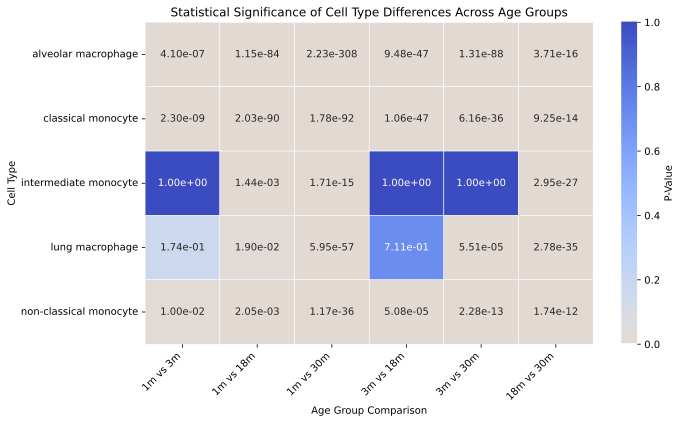

In [62]:
# Plot heatmap with scientific notation for very small p-values
plt.figure(figsize=(10, 6))
sns.heatmap(
    p_values_df, 
    annot=True, 
    cmap="coolwarm_r", 
    center=0.05,  
    linewidths=0.5,
    cbar_kws={'label': 'P-Value'},
    fmt=".2e"  # Show scientific notation (e.g., 1.2e-10)
)

plt.title("Statistical Significance of Cell Type Differences Across Age Groups")
plt.xlabel("Age Group Comparison")
plt.ylabel("Cell Type")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


/tmp/ipykernel_31202/2012051964.py:18: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  annot_labels = p_values_df.applymap(format_pval)


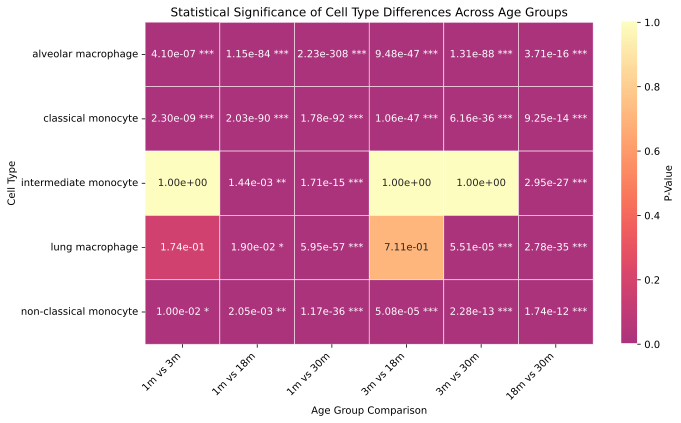

In [73]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Function to format p-values for annotation
def format_pval(p):
    """Formats p-values with scientific notation and adds significance markers."""
    if p < 0.001:
        return f"{p:.2e} ***"  # Highly significant
    elif p < 0.01:
        return f"{p:.2e} **"   # Moderately significant
    elif p < 0.05:
        return f"{p:.2e} *"    # Significant
    else:
        return f"{p:.2e}"      # Not significant

# Apply the function to format the heatmap labels
annot_labels = p_values_df.applymap(format_pval)

# Plot heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(
    p_values_df, 
    annot=annot_labels,  # Use formatted labels with significance markers
    cmap="magma", 
    center=0.05,  
    linewidths=0.5,
    cbar_kws={'label': 'P-Value'},
    fmt="",  # Disable default number formatting
    annot_kws={"size": 10}  # Adjust font size for readability
)

plt.title("Statistical Significance of Cell Type Differences Across Age Groups")
plt.xlabel("Age Group Comparison")
plt.ylabel("Cell Type")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [ ]:
# Plot Bar Graph for Cell Type Proportions
plt.figure(figsize=(10, 6))
cell_type_percentages.plot(kind='bar', stacked=True, cmap="viridis")

plt.ylabel("Percentage of Cells")
plt.xlabel("Age Group")
plt.title("Proportion of Each Cell Type Across Age Groups")
plt.legend(title="Cell Type", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Processing classical monocyte...


/tmp/ipykernel_31202/3738845204.py:23: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(age_subset)  # Clustering


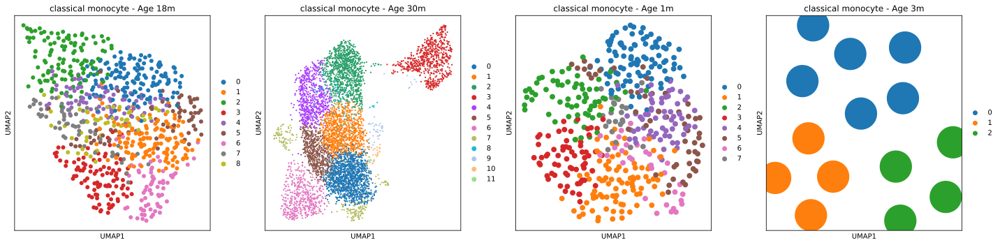

Processing non-classical monocyte...


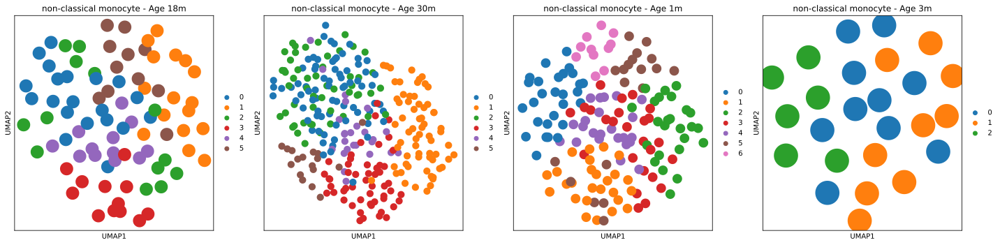

Processing alveolar macrophage...


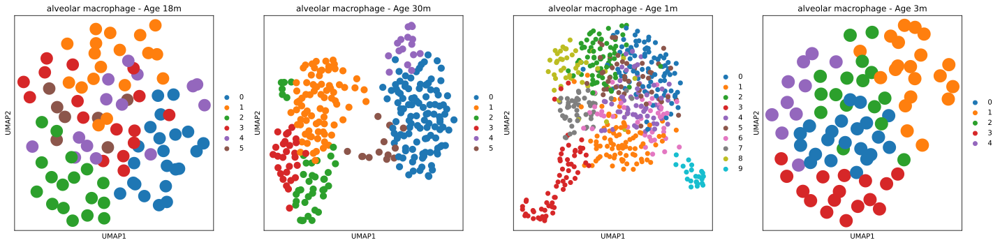

Processing lung macrophage...


/bioinformatics/miniconda3/envs/scanpy_env/lib/python3.10/site-packages/umap/spectral.py:519: RuntimeWarning: k >= N for N * N square matrix. Attempting to use scipy.linalg.eigh instead.
  eigenvalues, eigenvectors = scipy.sparse.linalg.eigsh(


TypeError: Cannot use scipy.linalg.eigh for sparse A with k >= N. Use scipy.linalg.eigh(A.toarray()) or reduce k.

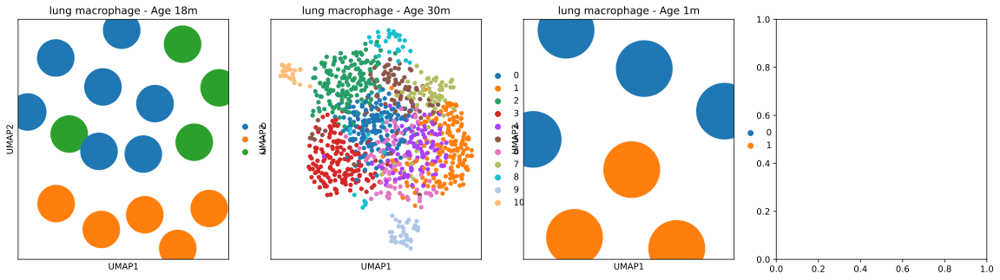

In [28]:
import matplotlib.pyplot as plt
import scanpy as sc

for cell_type, adata_subset in selected_adata_dfs.items():
    print(f"Processing {cell_type}...")

    # Get unique ages in the subset
    ages = adata_subset.obs['age'].unique()

    # Create a figure with subplots (one for each age)
    fig, axes = plt.subplots(1, len(ages), figsize=(5 * len(ages), 5))

    if len(ages) == 1:
        axes = [axes]  # Ensure axes is iterable even if only one subplot

    for ax, age in zip(axes, ages):
        # Subset by age
        age_subset = adata_subset[adata_subset.obs["age"] == age].copy()

        # Compute UMAP for this age group separately
        sc.pp.neighbors(age_subset)
        sc.tl.umap(age_subset)
        sc.tl.leiden(age_subset)  # Clustering

        # Plot UMAP with Leiden clusters
        sc.pl.umap(age_subset, color="leiden", ax=ax, title=f"{cell_type} - Age {age}", show=False)

    plt.tight_layout()
    plt.show()


Processing classical monocyte...


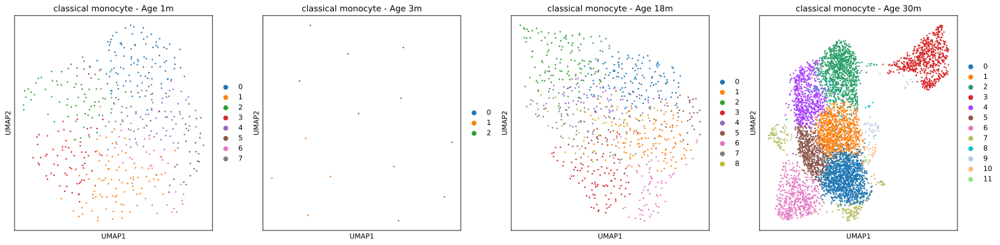

Processing non-classical monocyte...


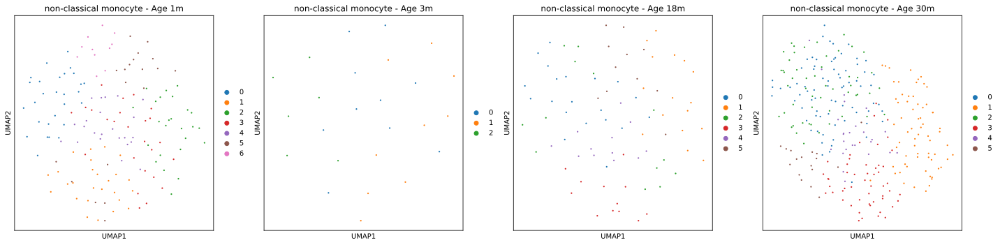

Processing alveolar macrophage...


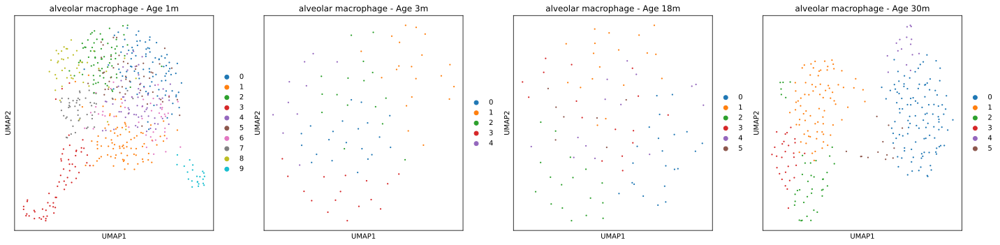

Processing lung macrophage...


/bioinformatics/miniconda3/envs/scanpy_env/lib/python3.10/site-packages/umap/spectral.py:519: RuntimeWarning: k >= N for N * N square matrix. Attempting to use scipy.linalg.eigh instead.
  eigenvalues, eigenvectors = scipy.sparse.linalg.eigsh(


TypeError: Cannot use scipy.linalg.eigh for sparse A with k >= N. Use scipy.linalg.eigh(A.toarray()) or reduce k.

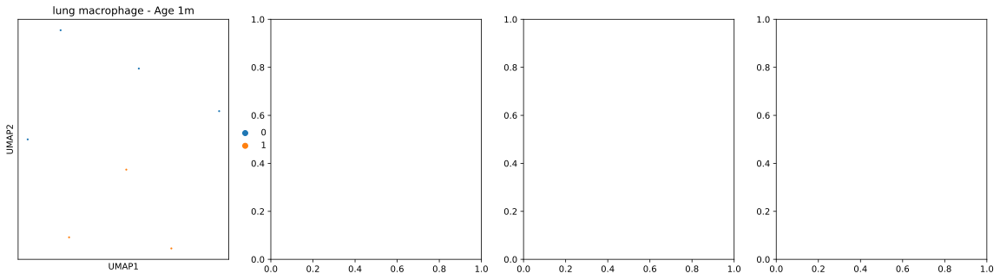

In [ ]:
import matplotlib.pyplot as plt
import scanpy as sc
import numpy as np

# Define fixed dot size
dot_size = 40  

for cell_type, adata_subset in selected_adata_dfs.items():
    print(f"Processing {cell_type}...")

    # Get unique ages and sort them
    ages = sorted(adata_subset.obs['age'].unique(), key=lambda x: int(x.replace('m', '')))

    # Create figure with subplots (one for each age, sorted)
    fig, axes = plt.subplots(1, len(ages), figsize=(5 * len(ages), 5))

    # Ensure axes is iterable even if only one subplot
    if len(ages) == 1:
        axes = [axes]  

    for ax, age in zip(axes, ages):
        # Subset by age
        age_subset = adata_subset[adata_subset.obs["age"] == age].copy()

        # Compute UMAP for this age group separately
        sc.pp.neighbors(age_subset)
        sc.tl.umap(age_subset)
        sc.tl.leiden(age_subset)  # Clustering

        # Plot UMAP with Leiden clusters, keeping dot size fixed
        sc.pl.umap(
            age_subset,
            color="leiden",
            ax=ax,
            title=f"{cell_type} - Age {age}",
            show=False,
            size=dot_size
        )

    plt.tight_layout()
    plt.show()


In [7]:
# Normalizing to median total counts
sc.pp.normalize_total(adata)
# Logarithmize the data
sc.pp.log1p(adata)

In [25]:
# Define the specific cell types of interest
selected_cell_types = [
    "classical monocyte",
    "non-classical monocyte",
    "alveolar macrophage",
    "lung macrophage",
    "intermediate monocyte"
]

# Create a dictionary of AnnData objects for each selected cell type
selected_adata_dfs = {cell_type: adata[adata.obs['cell_ontology_class'] == cell_type].copy()
                      for cell_type in selected_cell_types}

# Print number of cells per selected type
for cell_type, adata_subset in selected_adata_dfs.items():
    print(f"{cell_type}: {adata_subset.shape[0]} cells")


classical monocyte: 7407 cells
non-classical monocyte: 553 cells
alveolar macrophage: 1044 cells
lung macrophage: 1123 cells
intermediate monocyte: 1659 cells


In [ ]:
for cell_type, adata_subset in selected_adata_dfs.items():
    sc.pp.neighbors(adata_subset)  # Compute neighborhood graph
    sc.tl.umap(adata_subset)       # Compute UMAP
    sc.pl.umap(adata_subset, title=f"UMAP - {cell_type}", color="age")


In [8]:
sc.pp.highly_variable_genes(adata, n_top_genes=2000, batch_key="age")

In [9]:
# sc.pl.highly_variable_genes(adata)

In [9]:
sc.tl.pca(adata)

In [11]:
# sc.pl.pca_variance_ratio(adata, n_pcs=50, log=True)

In [57]:
# sc.pl.pca(
#     adata,
#     color=["age", "age", "pct_counts_mt", "pct_counts_mt"],
#     dimensions=[(0, 1), (2, 3), (0, 1), (2, 3)],
#     ncols=2,
#     size=2,
# )

In [10]:
sc.pp.neighbors(adata)

/bioinformatics/miniconda3/envs/scanpy_env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [11]:
sc.tl.umap(adata)

In [11]:
import seaborn as sns
%config InlineBackend.figure_format = 'svg'
# Define a pastel palette using Seaborn
pastel_palette = sns.color_palette("husl", n_colors=len(adata.obs['age'].unique()))
# pastel_palette = sns.color_palette("Set2", n_colors=len(adata.obs['age'].unique()))

# Plot the UMAP with the pastel palette
sc.pl.umap(
    adata,
    color="age",
    # Setting a smaller point size to get prevent overlap
    size=10,
    palette=pastel_palette
)

In [13]:
# Plot the UMAP with the pastel palette
sc.pl.umap(
    adata,
    color="cell_ontology_class",
    # Setting a smaller point size to get prevent overlap
    size=10,
)


In [18]:
adata.obs['cell_ontology_class'].unique().tolist()

['bronchial smooth muscle cell',
 'B cell',
 'CD8-positive, alpha-beta T cell',
 'classical monocyte',
 'NK cell',
 'non-classical monocyte',
 'ciliated columnar cell of tracheobronchial tree',
 'neutrophil',
 'vein endothelial cell',
 'T cell',
 'alveolar macrophage',
 'regulatory T cell',
 'fibroblast of lung',
 'smooth muscle cell of the pulmonary artery',
 'pericyte cell',
 'endothelial cell of lymphatic vessel',
 'type II pneumocyte',
 'lung macrophage',
 'adventitial cell',
 'intermediate monocyte',
 'myeloid dendritic cell',
 'mature NK T cell',
 'CD4-positive, alpha-beta T cell',
 'basophil',
 'pulmonary interstitial fibroblast',
 'plasmacytoid dendritic cell',
 'dendritic cell',
 'club cell of bronchiole',
 'plasma cell',
 'lung neuroendocrine cell']

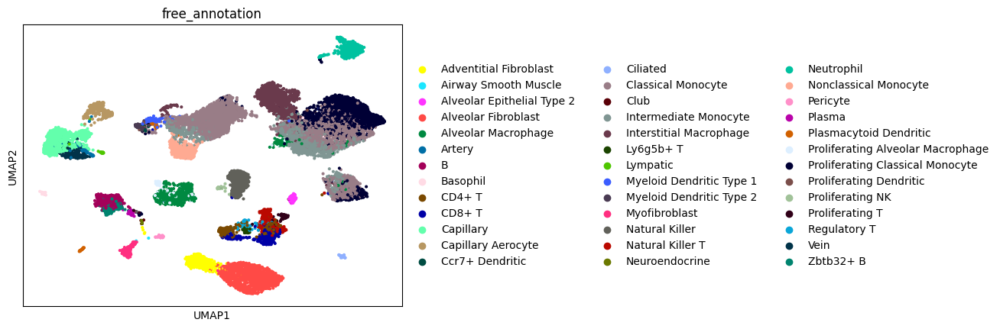

In [38]:
# %config InlineBackend.figure_format = 'svg'

# Set the directory where the plot will be saved
sc.settings.figdir = "/mnt/data/melhajjar/tabula_muris/lung_raw_data/figures"

# Save the UMAP plot
sc.pl.umap(
    adata,
    color="free_annotation",
    size=35,
    # save="umap_cell_ontology_class_high_quality.png"  # Only specify the file name here
)


In [19]:
# Using the igraph implementation and a fixed number of iterations can be significantly faster, especially for larger datasets
sc.tl.leiden(adata, flavor="igraph", n_iterations=2)

In [16]:
# sc.pl.umap(adata, color=["leiden"])

In [20]:
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(adata, groupby="age", method="wilcoxon")

In [18]:
# sc.settings.figdir = "/mnt/data/melhajjar/tabula_muris/lung_raw_data/figures"

# sc.pl.rank_genes_groups_dotplot(
#     adata, groupby="age", standard_scale="var", n_genes=5,
#     save="dotplot_top_difexp_genes.png"  # Only specify the file name here

# )

In [21]:
sc.get.rank_genes_groups_df(adata, group="30m").head(5)

,names,scores,logfoldchanges,pvals,pvals_adj
0,BETA-S,106.287918,6.127552,0.0,0.0
1,RPS27A,76.791412,1.157373,0.0,0.0
2,RPL10,74.699257,1.017997,0.0,0.0
3,RPS9,73.091553,1.136902,0.0,0.0
4,RPS19,71.325325,1.189578,0.0,0.0


In [23]:
dc_cluster_genes = sc.get.rank_genes_groups_df(adata, group="30m").head(5)["names"]
# sc.pl.umap(
#     adata,
#     color=[*dc_cluster_genes, "leiden_res_0.50"],
#     legend_loc="on data",
#     frameon=False,
#     ncols=3,
# )

In [42]:
# sc.pl.highest_expr_genes(adata, n_top=20)

In [24]:
import numpy as np

# Sum expression per gene
gene_expression_sums = adata.X.sum(axis=0)

# If adata.raw exists and is used for normalized counts:
# gene_expression_sums = adata.raw.X.sum(axis=0)

# Convert to a numpy array (if it's sparse)
if hasattr(gene_expression_sums, "A"):  # Check if sparse
    gene_expression_sums = gene_expression_sums.A1

# Get the indices of the top 20 most expressed genes
top_gene_indices = np.argsort(gene_expression_sums)[::-1][:20]

# Retrieve the gene names
top_gene_names = adata.var_names[top_gene_indices]

print("Top 20 expressed genes:", top_gene_names)


Top 20 expressed genes: Index(['TMSB4X', 'MALAT1', 'FTL1', 'RPL41', 'FAU', 'RPS29', 'RPL10', 'RPL13',
       'RPL18A', 'ACTB', 'TMSB10', 'RPS14', 'RPS27A', 'FTH1', 'RPS19', 'RPS23',
       'RPLP1', 'RPS16', 'EEF1A1', 'UBA52'],
      dtype='object')


In [43]:
# sc.pl.rank_genes_groups_violin(adata, groups="30m", n_genes=8)

In [44]:
sc.pl.violin(adata, top_gene_names, groupby="age")

In [30]:
# sc.pl.stacked_violin(adata, top_gene_names, groupby="age");

In [17]:
sc.tl.embedding_density(adata, groupby="age")

In [47]:
# %config InlineBackend.figure_format = 'svg'

# sc.pl.embedding_density(adata, groupby="age")

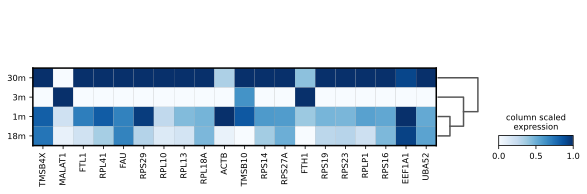

In [48]:
sc.pl.matrixplot(
    adata,
    top_gene_names,
    "age",
    dendrogram=True,
    cmap="Blues",
    standard_scale="var",
    colorbar_title="column scaled\nexpression",
)

In [18]:
# scale and store results in layer
adata.layers["scaled"] = sc.pp.scale(adata, copy=True).X

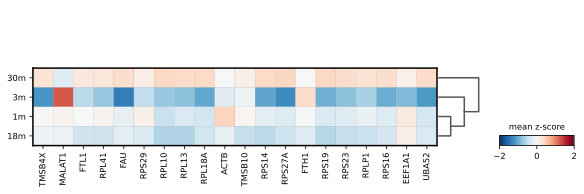

In [50]:
sc.pl.matrixplot(
    adata,
    top_gene_names,
    "age",
    dendrogram=True,
    colorbar_title="mean z-score",
    layer="scaled",
    vmin=-2,
    vmax=2,
    cmap="RdBu_r",
)

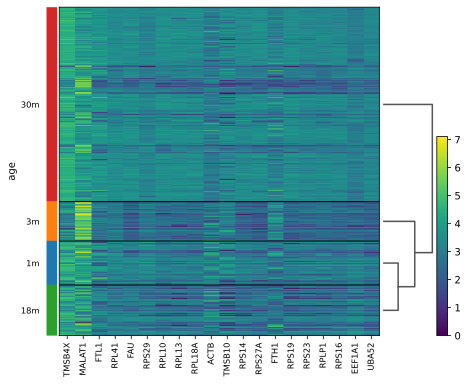

In [51]:
ax = sc.pl.heatmap(
    adata, top_gene_names, groupby="age", cmap="viridis", dendrogram=True
)

In [156]:
# Subset dataset for macrophages
# adata_macrophages = adata[adata.obs['free_annotation'] == 'Classical Monocyte']
adata_macrophages = adata[adata.obs['free_annotation'] == 'Alveolar Macrophage']
adata_macrophages.obs

,n_genes,age,cell,cell_ontology_class,cell_ontology_id,free_annotation,method,mouse.id,n_genes_meta,sex,subtissue,tissue,tissue_free_annotation,leiden,umap_density_age,age_class
AACACGTAGGATGGAA-1-31-0-0,1827,18m,MACA_18m_M_LUNG_52_AACACGTAGGATGGAA,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1827.0,male,NaN,Lung,Lung,10,0.135372,2
AATCGGTCAGTGACAG-1-31-0-0,2937,18m,MACA_18m_M_LUNG_52_AATCGGTCAGTGACAG,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,2937.0,male,NaN,Lung,Lung,10,0.145060,2
AGCATACTCATCGCTC-1-31-0-0,1869,18m,MACA_18m_M_LUNG_52_AGCATACTCATCGCTC,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1869.0,male,NaN,Lung,Lung,10,0.142532,2
AGTAGTCTCCTTGACC-1-31-0-0,1901,18m,MACA_18m_M_LUNG_52_AGTAGTCTCCTTGACC,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1901.0,male,NaN,Lung,Lung,10,0.147118,2
ATCATGGAGTCGAGTG-1-31-0-0,1631,18m,MACA_18m_M_LUNG_52_ATCATGGAGTCGAGTG,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1631.0,male,NaN,Lung,Lung,10,0.133463,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10X_P8_13_TGCCAAATCAGTTTGG-1,1902,3m,10X_P8_13_TGCCAAATCAGTTTGG,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.115342,1
10X_P8_13_TGCGGGTGTATCAGTC-1,1523,3m,10X_P8_13_TGCGGGTGTATCAGTC,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.101035,1
10X_P8_13_TGCTACCAGCCAGTTT-1,2100,3m,10X_P8_13_TGCTACCAGCCAGTTT,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.105245,1
10X_P8_13_TGTGGTAAGAAGGTGA-1,2161,3m,10X_P8_13_TGTGGTAAGAAGGTGA,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.107203,1


In [157]:
import scanpy as sc

# Normalize and log-transform
sc.pp.normalize_total(adata_macrophages, target_sum=1e4)
sc.pp.log1p(adata_macrophages)

# Select highly variable genes
sc.pp.highly_variable_genes(adata_macrophages, n_top_genes=2000)
adata_macrophages = adata_macrophages[:, adata_macrophages.var['highly_variable']]




/bioinformatics/miniconda3/envs/scanpy_env/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [158]:
# Map age strings to numerical values
age_map = {"1m": 1, "3m": 3, "18m": 18, "21m": 21, "30m": 30}
adata_macrophages.obs['age_numeric'] = adata_macrophages.obs['age'].map(age_map)


/tmp/ipykernel_1364/3427456776.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_macrophages.obs['age_numeric'] = adata_macrophages.obs['age'].map(age_map)


In [159]:
# Features (gene expression)
X = adata_macrophages.X

# Labels (numerical age)
y = adata_macrophages.obs['age_numeric'].values


In [160]:
if hasattr(X, "toarray"):  # Convert sparse to dense if needed
    X = X.toarray()


In [161]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Random Forest Regressor
model = RandomForestRegressor(random_state=42)
model.fit(X_train, y_train)

# Predict and evaluate
y_pred = model.predict(X_test)
print("Mean Absolute Error:", mean_absolute_error(y_test, y_pred))


Mean Absolute Error: 3.027696335078534


In [163]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

# Evaluate the model
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Absolute Error (MAE): {mae:.2f}")
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"R^2 Score: {r2:.2f}")


Mean Absolute Error (MAE): 3.03
Mean Squared Error (MSE): 25.33
R^2 Score: 0.84


In [ ]:
import matplotlib.pyplot as plt

# Scatter plot: Actual vs Predicted
plt.figure(figsize=(8, 6))
# plt.scatter(y_test, y_pred, alpha=0.7, edgecolors='k')
plt.scatter(y_test, y_pred, alpha=0.7, edgecolors='k', color='lightcoral')  # All dots will be blue

plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='black', linestyle='--', label='Ideal Fit')

plt.title('Actual vs Predicted Ages')
plt.xlabel('Actual Age')
plt.ylabel('Predicted Age (Months)')
plt.legend()
plt.grid(True)
# plt.show()
plt.savefig('/mnt/data/melhajjar/tabula_muris/lung_raw_data/figures/classicalmonocyte_actual_vs_predicted_age_random_forest.pdf', format='pdf')




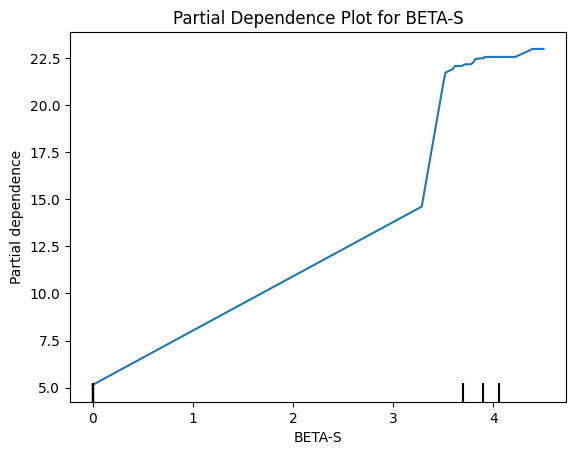

In [47]:
from sklearn.inspection import PartialDependenceDisplay

# Generate partial dependence for a top feature
PartialDependenceDisplay.from_estimator(
    model, X_test, [sorted_indices[0]], feature_names=adata_macrophages.var_names
)
plt.title(f"Partial Dependence Plot for {adata_macrophages.var_names[sorted_indices[0]]}")
plt.show()


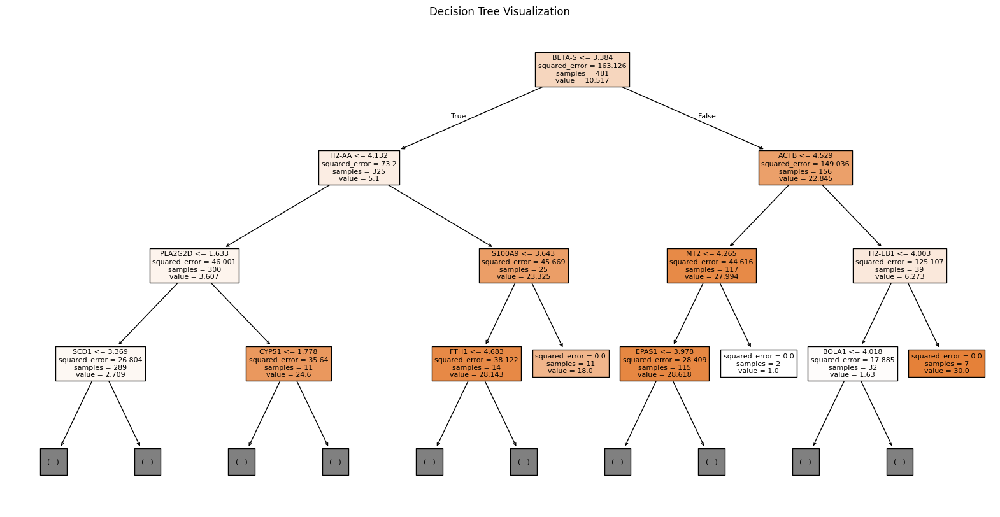

In [50]:
from sklearn.tree import plot_tree

# Plot one tree from the forest
plt.figure(figsize=(20, 10))
plot_tree(model.estimators_[0], feature_names=adata_macrophages.var_names, filled=True, max_depth=3)
plt.title("Decision Tree Visualization")
plt.show()


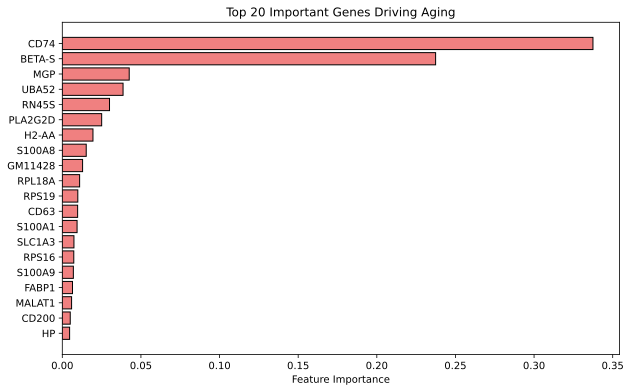

In [164]:
importances = model.feature_importances_
sorted_indices = np.argsort(importances)[::-1]

# Plot the top 20 most important genes
plt.figure(figsize=(10, 6))
plt.barh(range(20), importances[sorted_indices[:20]], align='center', color='lightcoral', edgecolor='k')
plt.yticks(range(20), adata_macrophages.var_names[sorted_indices[:20]])
plt.gca().invert_yaxis()
plt.title('Top 20 Important Genes Driving Aging')
plt.xlabel('Feature Importance')
# plt.show()
plt.savefig('/mnt/data/melhajjar/tabula_muris/lung_raw_data/figures/classicalmonocyte_gene_vs_age_final_featureplot.pdf', format='pdf')



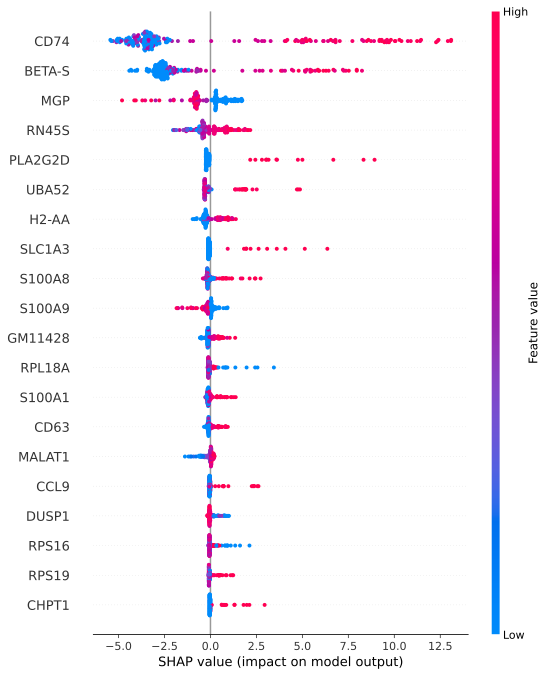

In [96]:
%config InlineBackend.figure_format = 'svg'

import shap

# Explain the model's predictions
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# Summary plot
shap.summary_plot(shap_values, features=X_test, feature_names=adata_macrophages.var_names)

# plt.savefig('/mnt/data/melhajjar/tabula_muris/lung_raw_data/figures/ams_shap_summary_plot.pdf')


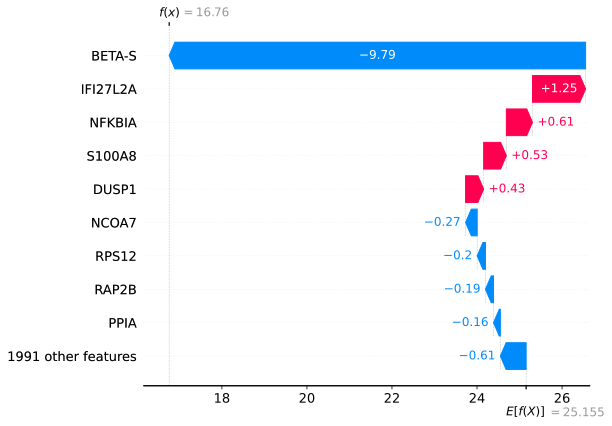

In [74]:
%config InlineBackend.figure_format = 'svg'

shap.waterfall_plot(shap.Explanation(values=shap_values[0], base_values=explainer.expected_value, feature_names=adata_macrophages.var_names))


In [209]:
adata_macrophages = adata[adata.obs['free_annotation'] == 'Alveolar Macrophage']
adata_macrophages.obs

,n_genes,age,cell,cell_ontology_class,cell_ontology_id,free_annotation,method,mouse.id,n_genes_meta,sex,subtissue,tissue,tissue_free_annotation,leiden,umap_density_age,age_class
AACACGTAGGATGGAA-1-31-0-0,1827,18m,MACA_18m_M_LUNG_52_AACACGTAGGATGGAA,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1827.0,male,NaN,Lung,Lung,10,0.135372,2
AATCGGTCAGTGACAG-1-31-0-0,2937,18m,MACA_18m_M_LUNG_52_AATCGGTCAGTGACAG,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,2937.0,male,NaN,Lung,Lung,10,0.145060,2
AGCATACTCATCGCTC-1-31-0-0,1869,18m,MACA_18m_M_LUNG_52_AGCATACTCATCGCTC,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1869.0,male,NaN,Lung,Lung,10,0.142532,2
AGTAGTCTCCTTGACC-1-31-0-0,1901,18m,MACA_18m_M_LUNG_52_AGTAGTCTCCTTGACC,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1901.0,male,NaN,Lung,Lung,10,0.147118,2
ATCATGGAGTCGAGTG-1-31-0-0,1631,18m,MACA_18m_M_LUNG_52_ATCATGGAGTCGAGTG,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1631.0,male,NaN,Lung,Lung,10,0.133463,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10X_P8_13_TGCCAAATCAGTTTGG-1,1902,3m,10X_P8_13_TGCCAAATCAGTTTGG,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.115342,1
10X_P8_13_TGCGGGTGTATCAGTC-1,1523,3m,10X_P8_13_TGCGGGTGTATCAGTC,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.101035,1
10X_P8_13_TGCTACCAGCCAGTTT-1,2100,3m,10X_P8_13_TGCTACCAGCCAGTTT,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.105245,1
10X_P8_13_TGTGGTAAGAAGGTGA-1,2161,3m,10X_P8_13_TGTGGTAAGAAGGTGA,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.107203,1


In [210]:
import pandas as pd

# Define the age categories (map the ages to class labels)
age_to_class = {"1m": 0, "3m": 1, "18m": 2, "30m": 3}

# Map 'age' to class labels and store it in a new column in adata.obs
adata_macrophages.obs['age_class'] = adata_macrophages.obs['age'].map(age_to_class)


/tmp/ipykernel_1364/1058733110.py:7: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_macrophages.obs['age_class'] = adata_macrophages.obs['age'].map(age_to_class)


In [211]:
adata_macrophages.obs['age_class']

AACACGTAGGATGGAA-1-31-0-0       2
AATCGGTCAGTGACAG-1-31-0-0       2
AGCATACTCATCGCTC-1-31-0-0       2
AGTAGTCTCCTTGACC-1-31-0-0       2
ATCATGGAGTCGAGTG-1-31-0-0       2
                               ..
10X_P8_13_TGCCAAATCAGTTTGG-1    1
10X_P8_13_TGCGGGTGTATCAGTC-1    1
10X_P8_13_TGCTACCAGCCAGTTT-1    1
10X_P8_13_TGTGGTAAGAAGGTGA-1    1
10X_P8_13_TTGTAGGAGACCTAGG-1    1
Name: age_class, Length: 951, dtype: category
Categories (4, int64): [0, 1, 2, 3]

In [218]:
from sklearn.model_selection import train_test_split

# Make sure the target is in a separate variable (age_class)
X = adata_macrophages.X  # Gene expression data (features)
y = adata_macrophages.obs['age_class']  # Age classes (labels)

# Split into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


In [219]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score

# Convert sparse matrix to dense if necessary
X_train_dense = X_train.toarray() if hasattr(X_train, 'toarray') else X_train
X_test_dense = X_test.toarray() if hasattr(X_test, 'toarray') else X_test

# Initialize the Random Forest Classifier
clf = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the classifier
clf.fit(X_train_dense, y_train)

# Make predictions on the test set
y_pred = clf.predict(X_test_dense)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")
print(classification_report(y_test, y_pred))


Accuracy: 0.71
              precision    recall  f1-score   support

           0       0.65      0.99      0.78       148
           1       1.00      0.08      0.14        26
           2       0.00      0.00      0.00        31
           3       0.93      0.65      0.77        81

    accuracy                           0.71       286
   macro avg       0.64      0.43      0.42       286
weighted avg       0.69      0.71      0.64       286



/bioinformatics/miniconda3/envs/scanpy_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/bioinformatics/miniconda3/envs/scanpy_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/bioinformatics/miniconda3/envs/scanpy_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

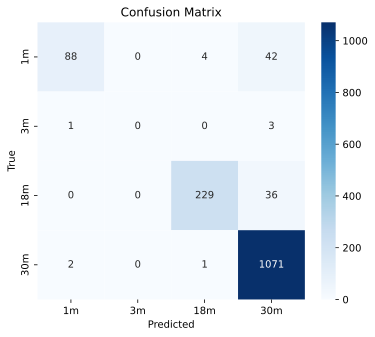

In [203]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix using a heatmap
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['1m', '3m', '18m', '30m'],
            yticklabels=['1m', '3m', '18m', '30m'])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()


[ 7413  6788  6666 14102  6665  9818 13759 13588 14858  1820 14058  1983
  8508 12241 13154  6667  1694  6659  9814  6504]


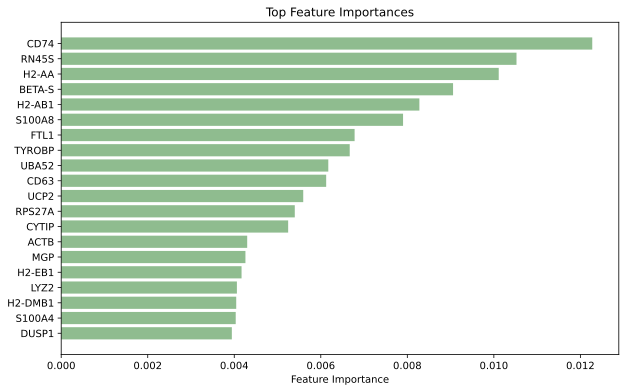

In [220]:
# Get feature importance from the trained Random Forest model
importances = clf.feature_importances_

# If the feature matrix X is large, it's better to limit the number of top features to display
top_n = 20  # Change this number based on your needs

# Get the indices of the top features
indices = importances.argsort()[-top_n:][::-1]

print(indices)
# Plot the top N feature importances
plt.figure(figsize=(10, 6))
plt.barh(range(top_n), importances[indices], align='center', color='darkseagreen')
plt.xlabel('Feature Importance')
plt.title('Top Feature Importances')
plt.yticks(range(20), adata_macrophages.var_names[indices[:20]])
plt.gca().invert_yaxis()  # To display the highest importance at the top
# plt.savefig('/mnt/data/melhajjar/tabula_muris/lung_raw_data/figures/am_random_forest_categories_top_features2.pdf', format='pdf')


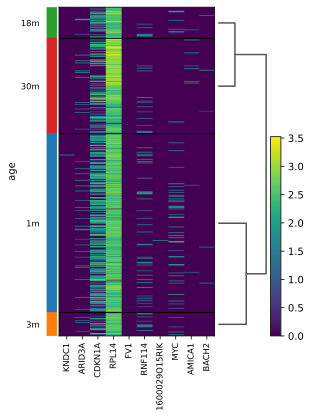

In [113]:
top_gene_names = adata_macrophages.var_names[indices[:10]].tolist()

ax = sc.pl.heatmap(
    adata_macrophages, top_gene_names, groupby="age", cmap="viridis", dendrogram=True
)

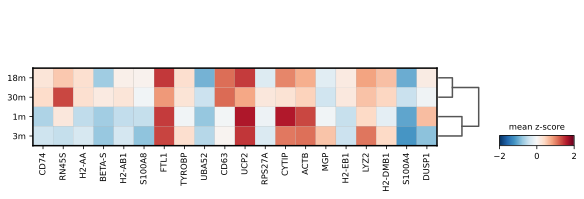

In [221]:
sc.settings.figdir = "/mnt/data/melhajjar/tabula_muris/lung_raw_data/figures"

top_gene_names = adata_macrophages.var_names[indices[:20]].tolist()

sc.pl.matrixplot(
    adata_macrophages,
    top_gene_names,
    "age",
    dendrogram=True,
    colorbar_title="mean z-score",
    layer="scaled",
    vmin=-2,
    vmax=2,
    cmap="RdBu_r",
    # save="am_random_forest_categories_top_features2_heatmap.pdf"  # Only specify the file name here
)

/tmp/ipykernel_1364/841724691.py:19: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  class_accuracy = accuracy_score(y_test[class_indices], y_pred[class_indices])
/tmp/ipykernel_1364/841724691.py:19: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  class_accuracy = accuracy_score(y_test[class_indices], y_pred[class_indices])
/tmp/ipykernel_1364/841724691.py:19: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  class_accuracy = accuracy_score

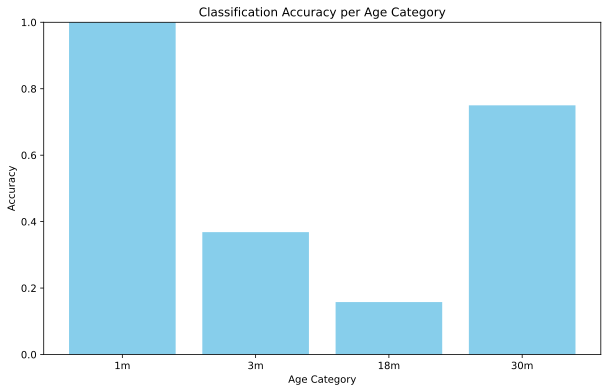

In [196]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
import numpy as np
from sklearn.metrics import accuracy_score

# Define the custom age labels
age_labels = ['1m', '3m', '18m', '21m', '30m']

# Calculate accuracy per class (each age category)
class_accuracies = []
classes = np.unique(y_test)

for c in classes:
    # Get indices of samples that belong to class c
    class_indices = np.where(y_test == c)[0]
    
    # Calculate accuracy for class c
    class_accuracy = accuracy_score(y_test[class_indices], y_pred[class_indices])
    class_accuracies.append(class_accuracy)

# Plot the accuracies per class
plt.figure(figsize=(10, 6))
plt.bar(classes, class_accuracies, color='skyblue')
plt.xlabel('Age Category')
plt.ylabel('Accuracy')
plt.title('Classification Accuracy per Age Category')
plt.xticks(classes, ['1m', '3m', '18m', '30m'])
plt.ylim(0, 1)  # Accuracy range from 0 to 1
plt.show()


In [73]:
# import matplotlib.pyplot as plt

# # Scatter plot: Actual vs Predicted
# plt.figure(figsize=(8, 6))
# # plt.scatter(y_test, y_pred, alpha=0.7, edgecolors='k')
# plt.scatter(y_test, y_pred, alpha=0.7, edgecolors='k', color='lightcoral')  # All dots will be blue

# plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='black', linestyle='--', label='Ideal Fit')

# plt.title('Actual vs Predicted Ages')
# plt.xlabel('Actual Age')
# plt.ylabel('Predicted Age (Months)')
# plt.legend()
# plt.grid(True)
# plt.show()
# plt.savefig('/mnt/data/melhajjar/tabula_muris/lung_raw_data/figures/classicalmonocyte_actual_vs_predicted_age_random_forest.pdf', format='pdf')

/bioinformatics/miniconda3/envs/scanpy_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/bioinformatics/miniconda3/envs/scanpy_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/bioinformatics/miniconda3/envs/scanpy_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

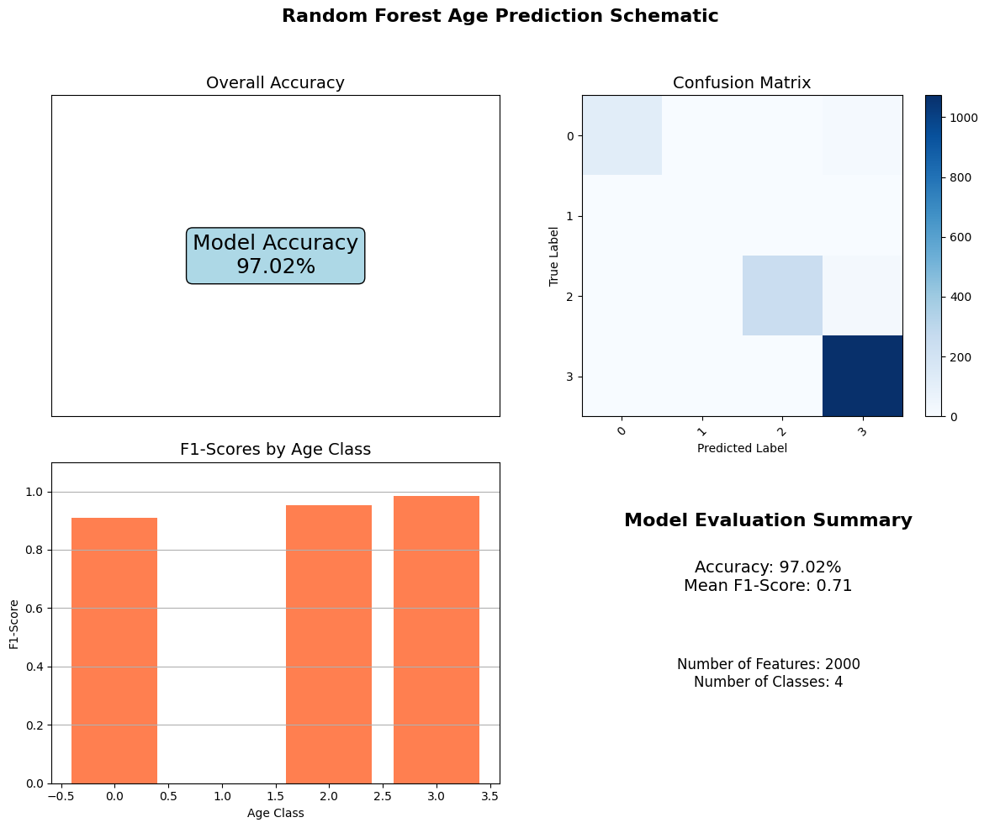

In [59]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

# Generate classification metrics
accuracy = accuracy_score(y_test, y_pred)
class_report = classification_report(y_test, y_pred, output_dict=True)
conf_matrix = confusion_matrix(y_test, y_pred)
class_names = clf.classes_

# Extract F1-scores for each class
f1_scores = [class_report[str(cls)]['f1-score'] for cls in class_names]

# Visualization
fig, axes = plt.subplots(2, 2, figsize=(12, 10))
fig.suptitle("Random Forest Age Prediction Schematic", fontsize=16, fontweight="bold")

# Subplot 1: Accuracy
axes[0, 0].text(0.5, 0.5, f"Model Accuracy\n{accuracy:.2%}", 
                fontsize=18, ha='center', va='center', bbox=dict(boxstyle="round", facecolor="lightblue"))
axes[0, 0].set_xticks([])
axes[0, 0].set_yticks([])
axes[0, 0].set_title("Overall Accuracy", fontsize=14)

# Subplot 2: Confusion Matrix
axes[0, 1].set_title("Confusion Matrix", fontsize=14)
im = axes[0, 1].imshow(conf_matrix, interpolation="nearest", cmap="Blues")
plt.colorbar(im, ax=axes[0, 1])
axes[0, 1].set_xticks(range(len(class_names)))
axes[0, 1].set_xticklabels(class_names, rotation=45)
axes[0, 1].set_yticks(range(len(class_names)))
axes[0, 1].set_yticklabels(class_names)
axes[0, 1].set_xlabel("Predicted Label")
axes[0, 1].set_ylabel("True Label")

# Subplot 3: F1-scores per class
axes[1, 0].bar(class_names, f1_scores, color="coral")
axes[1, 0].set_title("F1-Scores by Age Class", fontsize=14)
axes[1, 0].set_xlabel("Age Class")
axes[1, 0].set_ylabel("F1-Score")
axes[1, 0].set_ylim(0, 1.1)
axes[1, 0].grid(axis="y")

# Subplot 4: Summary Schematic
axes[1, 1].text(0.5, 0.8, "Model Evaluation Summary", fontsize=16, ha="center", fontweight="bold")
axes[1, 1].text(0.5, 0.6, f"Accuracy: {accuracy:.2%}\nMean F1-Score: {np.mean(f1_scores):.2f}", 
                fontsize=14, ha="center")
axes[1, 1].text(0.5, 0.3, f"Number of Features: {X_train.shape[1]}\nNumber of Classes: {len(class_names)}", 
                fontsize=12, ha="center")
axes[1, 1].set_xticks([])
axes[1, 1].set_yticks([])
axes[1, 1].set_frame_on(False)

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()




Text(70.72222222222221, 0.5, 'True Labels')

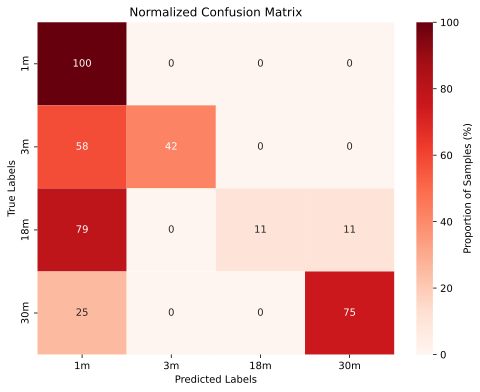

In [195]:
import numpy as np
conf_matrix_normalized = (conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]) * 100
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_normalized, annot=True, fmt=".0f", cmap="Reds", 
            xticklabels=['1m', '3m', '18m', '30m'],
            yticklabels=['1m', '3m', '18m', '30m'],
            cbar_kws={'label': 'Proportion of Samples (%)'}  # Add label to the colorbar
)
plt.title("Normalized Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
# plt.savefig('/mnt/data/melhajjar/tabula_muris/lung_raw_data/figures/classicalmonocyte_actual_vs_predicted_age_random_forest_categories_normalized_conf_matrix.pdf', format='pdf')
# plt.show()


In [74]:
# from sklearn.metrics import classification_report
# import pandas as pd

# # Get classification report as a DataFrame
# report = classification_report(y_test, y_pred, output_dict=True)
# class_metrics = pd.DataFrame(report).transpose()

# # Plot F1-scores
# class_metrics[:-3].plot(kind="bar", y="f1-score", legend=False, figsize=(10, 6), color="coral")
# plt.title("F1-Scores by Class")
# plt.xlabel("Class")
# plt.ylabel("F1-Score")
# plt.grid(axis="y")
# plt.show()


In [179]:
adata_macrophages.obs

,n_genes,age,cell,cell_ontology_class,cell_ontology_id,free_annotation,method,mouse.id,n_genes_meta,sex,subtissue,tissue,tissue_free_annotation,leiden,umap_density_age,age_class,age_numeric
AACACGTAGGATGGAA-1-31-0-0,1827,18m,MACA_18m_M_LUNG_52_AACACGTAGGATGGAA,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1827.0,male,NaN,Lung,Lung,10,0.135372,2,18
AATCGGTCAGTGACAG-1-31-0-0,2937,18m,MACA_18m_M_LUNG_52_AATCGGTCAGTGACAG,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,2937.0,male,NaN,Lung,Lung,10,0.145060,2,18
AGCATACTCATCGCTC-1-31-0-0,1869,18m,MACA_18m_M_LUNG_52_AGCATACTCATCGCTC,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1869.0,male,NaN,Lung,Lung,10,0.142532,2,18
AGTAGTCTCCTTGACC-1-31-0-0,1901,18m,MACA_18m_M_LUNG_52_AGTAGTCTCCTTGACC,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1901.0,male,NaN,Lung,Lung,10,0.147118,2,18
ATCATGGAGTCGAGTG-1-31-0-0,1631,18m,MACA_18m_M_LUNG_52_ATCATGGAGTCGAGTG,alveolar macrophage,NaN,Alveolar Macrophage,droplet,18-M-52,1631.0,male,NaN,Lung,Lung,10,0.133463,2,18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10X_P8_13_TGCCAAATCAGTTTGG-1,1902,3m,10X_P8_13_TGCCAAATCAGTTTGG,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.115342,1,3
10X_P8_13_TGCGGGTGTATCAGTC-1,1523,3m,10X_P8_13_TGCGGGTGTATCAGTC,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.101035,1,3
10X_P8_13_TGCTACCAGCCAGTTT-1,2100,3m,10X_P8_13_TGCTACCAGCCAGTTT,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.105245,1,3
10X_P8_13_TGTGGTAAGAAGGTGA-1,2161,3m,10X_P8_13_TGTGGTAAGAAGGTGA,alveolar macrophage,CL:0000583,Alveolar Macrophage,droplet,3-M-7/8,NaN,male,immune-endo-depleted,Lung,Lung,10,0.107203,1,3


Random Forest Accuracy: 0.7853403141361257
              precision    recall  f1-score   support

           0       0.73      1.00      0.84       101
           1       1.00      0.37      0.54        19
           2       1.00      0.16      0.27        19
           3       0.93      0.75      0.83        52

    accuracy                           0.79       191
   macro avg       0.91      0.57      0.62       191
weighted avg       0.84      0.79      0.75       191

Top 20 Features: ['S100A8', 'S100A9', 'MGP', 'BETA-S', 'CD74', 'RN45S', 'GSN', 'DUSP1', 'RETNLG', 'RPS14', 'GM11428', 'CD63', 'RPS18', 'H2-AA', 'H2-EB1', 'RPL32', 'RPS23', 'EAR2', 'RPS19', 'LYZ1']


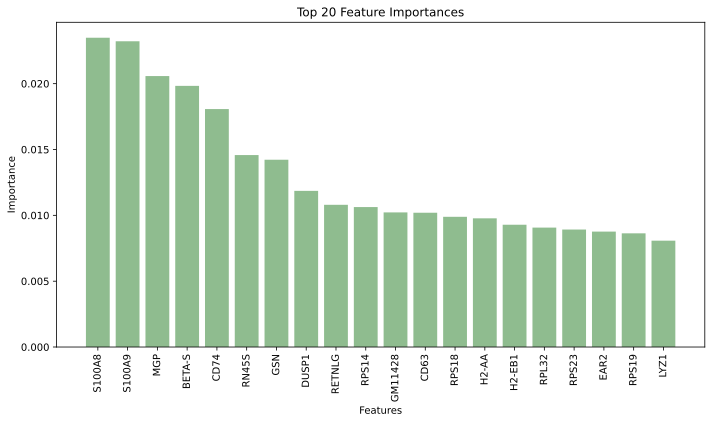

In [190]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score
import matplotlib.pyplot as plt

# Assume X (features) and y (target labels) are already defined
# Replace X and y with your actual dataset
X = adata_macrophages.X
y = adata_macrophages.obs['age_class']

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42, class_weight="balanced")
rf_model.fit(X_train, y_train)

# Make predictions and evaluate
y_pred = rf_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Random Forest Accuracy:", accuracy)
print(classification_report(y_test, y_pred))

# Extract Feature Importances
feature_importances = rf_model.feature_importances_

# Get the indices of the top 20 features
indices = np.argsort(feature_importances)[::-1][:20]  # Indices of top 20 features

# Get the names of the top 20 features
top_features = adata_macrophages.var_names[indices].tolist()

# Print top features
print("Top 20 Features:", top_features)

# Plot the top 20 features
plt.figure(figsize=(10, 6))
plt.bar(range(len(indices)), feature_importances[indices], align="center", color = "darkseagreen")
plt.xticks(range(len(indices)), top_features, rotation=90)
plt.title("Top 20 Feature Importances")
plt.xlabel("Features")
plt.ylabel("Importance")
plt.tight_layout()
plt.savefig('/mnt/data/melhajjar/tabula_muris/lung_raw_data/figures/am_random_forest_categories_normalized_feature importance.pdf', format='pdf')



In [185]:
adata_macrophages.X

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 183309 stored elements and shape (951, 2000)>

In [151]:
adata_macrophages.X

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 1716504 stored elements and shape (951, 16938)>

In [173]:
top_features = adata_macrophages.var_names[indices].tolist()
top_features

['BETA-S',
 'H2-AA',
 'CD74',
 'RN45S',
 'S100A8',
 'H2-AB1',
 'DUSP1',
 'RPS16',
 'H2-EB1',
 'SLPI',
 'RPL13',
 'UBA52',
 'GM11428',
 'CYTIP',
 'RPS23',
 'RPS14',
 'RPS18',
 'CD63',
 'S100A1',
 'RPS19']

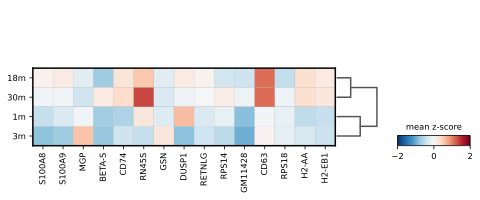

In [194]:
%config InlineBackend.figure_format = 'svg'

# Get the indices of the top 20 features
indices = np.argsort(feature_importances)[::-1][:15]  # Indices of top 20 features

# Get the names of the top 20 features
top_features = adata_macrophages.var_names[indices].tolist()

sc.pl.matrixplot(
    adata_macrophages,
    top_features,
    "age",
    dendrogram=True,
    colorbar_title="mean z-score",
    layer="scaled",
    vmin=-2,
    vmax=2,
    cmap="RdBu_r",
)
